<a href="https://colab.research.google.com/github/NiteeshSingh/SOC-Season-Of-Codes/blob/main/Pix2Pix%20for%20Cartoonizing%20Images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd

import torch
import torchvision

import os

import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from PIL import Image

from IPython import display

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Downloading Dataset

In [ ]:
!mkdir ~/.kaggle
!cp /content/drive/MyDrive/Kaggle/kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download defileroff/comic-faces-paired-synthetic-v2

100% 2.17G/2.18G [01:07<00:00, 56.5MB/s]
100% 2.18G/2.18G [01:07<00:00, 34.7MB/s]


In [ ]:
!unzip /content/comic-faces-paired-synthetic-v2.zip

In [ ]:
!rm -r /content/samples

In [ ]:
!mv /content/face2comics_v2.0.0_by_Sxela/face2comics_v2.0.0_by_Sxela/comics /content

In [ ]:
!mv /content/face2comics_v2.0.0_by_Sxela/face2comics_v2.0.0_by_Sxela/faces /content

In [ ]:
!mv /content/face2comics_v2.0.0_by_Sxela/face2comics_v2.0.0_by_Sxela/samples /content

In [ ]:
!rm -r /content/face2comics_v2.0.0_by_Sxela

#Parameters

In [ ]:
BATCH_SIZE = 1
IMG_SIZE = 256
NUM_IMAGES_TO_TRAIN = 100 #we will train on first this many images

# Data preparation

* all the images are of size 1024 x 1024 pixel

In [ ]:
comic_root = '/content/comics/'
real_root = '/content/faces/'

In [ ]:
comic_fnames = [comic_root+name for name in os.listdir('/content/comics')]
len(comic_fnames), comic_fnames[0]

(10000, '/content/comics/8514.jpg')

In [ ]:
real_fnames = [real_root+name for name in os.listdir('/content/faces')]
len(real_fnames), real_fnames[0]

(10000, '/content/faces/8514.jpg')

Dataset Class

In [ ]:
class Dataset(torch.utils.data.Dataset):
  '''
  Dataset class to effectively load data from directory
  Parameters:
    cfname --> list containing path of all the cartoonized image files
    rname --> list containing path of all the real images
    transforms --> all the transforms that will be applied to image 
    toCache --> whether to cached the data in memory once loaded or not

  Note:
    1- You must pass 'transforms.PILToTensor()' with transforms argument 
      else PIL image will not be converted to array
    2-if caching is on it will store the images in a dictionary format 
      where key is the index of image and value is transformed image matrix
  '''
  def __init__(self, cfname, rfname, transforms, toCache=True):
    self.cfname = cfname
    self.rfname = rfname
    self.transforms = transforms
    self.toCache = toCache
    self.cachedData = {}

  def __len__(self):
    return len(self.rfname)
  
  def __getitem__(self, index):
    if not self.toCache:
      return (self.transforms(Image.open(self.cfname[index])), self.transforms(Image.open(self.rfname[index])))
    else:
      if index not in self.cachedData:
        self.cachedData[index] = (self.transforms(Image.open(self.cfname[index])), self.transforms(Image.open(self.rfname[index])))
      return self.cachedData[index]


In [ ]:
transforms = torchvision.transforms.Compose([
                    torchvision.transforms.PILToTensor(), # to convert PIL image to torch tensor
                    torchvision.transforms.Resize(IMG_SIZE),#cropping out the desired size at center
                    torchvision.transforms.ConvertImageDtype(torch.float), # to cnvert datatype to float
                    torchvision.transforms.Normalize((0.5,), (0.5,)) #normalize the values in range of [-1, 1]        
])

Shorten datset

In [ ]:
comic_fnames_s = comic_fnames[:NUM_IMAGES_TO_TRAIN]
real_fnames_s = real_fnames[:NUM_IMAGES_TO_TRAIN]

In [ ]:
dataset = Dataset(comic_fnames_s, real_fnames_s, transforms, toCache=True)

In [ ]:
dataloader = torch.utils.data.DataLoader(dataset, BATCH_SIZE, shuffle=True, drop_last=True, prefetch_factor=2)

In [ ]:
x = iter(dataloader).next()
x[0].shape, x[1].shape #cartoonized, real images

(torch.Size([1, 3, 256, 256]), torch.Size([1, 3, 256, 256]))

In [ ]:
def show_batch_images(image_tensor, num_images=BATCH_SIZE, size=(IMG_SIZE, IMG_SIZE), nrow=None, ax=None, title="Images"):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    if nrow==None:
      nrow = (num_images+8)//8

    image_tensor = (image_tensor + 1) / 2 #converting images from [-1, 1] to [0, 1]
    image_unflat = image_tensor.detach().cpu()
    image_grid = torchvision.utils.make_grid(image_unflat[:num_images], nrow=nrow)

    if ax==None:
      plt.imshow((image_grid.permute(1, 2, 0).squeeze().cpu().detach().numpy()* 255).astype(np.uint8))
      plt.axis('off')
      plt.title(title)
      plt.show()
    else:
      ax.imshow((image_grid.permute(1, 2, 0).squeeze().cpu().detach().numpy()* 255).astype(np.uint8))
      ax.axis('off')
      ax.set_title(title)

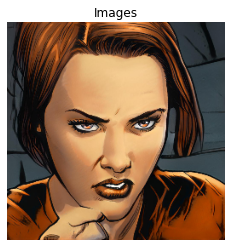

In [ ]:
show_batch_images(x[0])

#Model Building

OUr generator will follow similar structure but our image dimensions are different

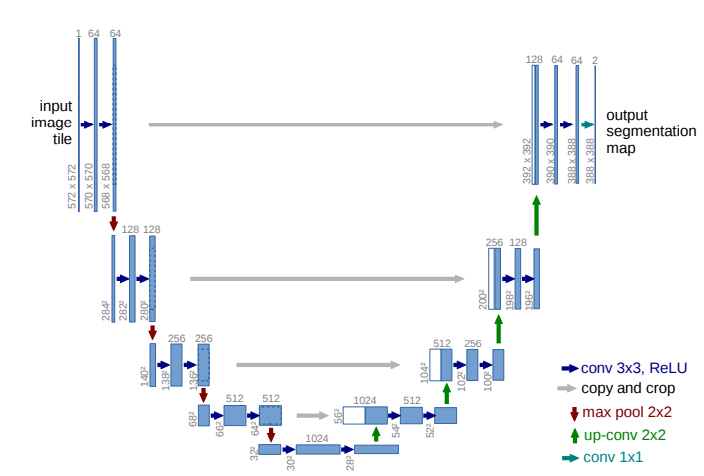

U-Net Implementation

In [ ]:
############################ Blocks Definitions ##############################
                #--- contracting block ----#
def contracting_block_g(input_ch, output_ch):
  '''
  This class generate a contracting block of our U-Net model

  Parameters:
    input_ch --> number of input channels
    output_ch --> output channels need
  '''
  return torch.nn.Sequential(
    torch.nn.Conv2d(input_ch, output_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(output_ch),
    torch.nn.LeakyReLU(0.2),

    torch.nn.Conv2d(output_ch, output_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(output_ch),
    torch.nn.LeakyReLU(0.2),
  )
              #--- expanding block ----#
def expanding_block_g(input_ch, mid_ch, output_ch):
  '''
  This class generate a expanding block for our U-Net generator

  Parameters:
    input_ch-->number of input channels (final number of channels after concatenation)
    mid_ch---> number of channel in  middle of input and output of expanding block
    output_ch-->number of output channels after upsampling
  '''
  return torch.nn.Sequential(
    torch.nn.Conv2d(input_ch, mid_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(mid_ch),
    torch.nn.LeakyReLU(0.2),

    torch.nn.Conv2d(mid_ch, mid_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(mid_ch),
    torch.nn.LeakyReLU(0.2),

    torch.nn.ConvTranspose2d(mid_ch, output_ch, kernel_size=3, stride=2, padding=1, output_padding=1)
  )
              #--- final block ----#
def final_block_g(input_ch, mid_ch, output_ch):
  '''
  This class generate a expanding block for our U-Net generator

  Parameters:
    input_ch-->number of input channels (final number of channels after concatenation)
    mid_ch---> number of channel in  middle of input and output of expanding block
    output_ch-->number of output channels "without" upsampling
  '''
  return torch.nn.Sequential(
    torch.nn.Conv2d(input_ch, mid_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(mid_ch),
    torch.nn.LeakyReLU(0.2),

    torch.nn.Conv2d(mid_ch, mid_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(mid_ch),
    torch.nn.LeakyReLU(0.2),

    torch.nn.Conv2d(mid_ch, output_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(output_ch),
    torch.nn.LeakyReLU(0.2),

    #torch.nn.Tanh()
  )

class U_Net(torch.nn.Module):
  def __init__(self, input_ch, output_ch, dim=32):
    super(U_Net, self).__init__() 
    self.maxpool = torch.nn.MaxPool2d(kernel_size=2, stride=2)
    self.dropout = torch.nn.Dropout()

    ######################### creating Blocks ##################################
                #--- contracting ----#
    self.c1 = contracting_block_g(input_ch, 2*dim) # 3-64-64
    self.c2 = contracting_block_g(2*dim, 4*dim) #64-128-128
    self.c3 = contracting_block_g(4*dim, 8*dim) #128-256-256
    self.c4 = contracting_block_g(8*dim, 16*dim) # 256-512-512
                #--- bottel neck ----#
    self.b = expanding_block_g(16*dim, 32*dim, 16*dim) #512-1024-1024-512
                #--- expanding ----#
    self.e1 = expanding_block_g(32*dim, 16*dim, 8*dim) #1024-512-512-256
    self.e2 = expanding_block_g(16*dim, 8*dim, 4*dim) #512-256-256-128
    self.e3 = expanding_block_g(8*dim, 4*dim, 2*dim) #256-128-128-64
                #--- final block ----#
    self.f = final_block_g(4*dim, 2*dim, output_ch) #128-64-64-3
  
  ############################ forward method ##################################
  def forward(self, x):
    x1 = self.c1(x)
    mpx1 = self.maxpool(x1)
    x2 = self.c2(mpx1)
    mpx2 = self.maxpool(x2)
    x3 = self.c3(mpx2)
    mpx3 = self.maxpool(x3)
    x4 = self.c4(mpx3)
    mpx4 = self.maxpool(x4)

    xb = self.b(mpx4)
    xb = self.dropout(xb)

    ex1 = self.e1(torch.cat([xb, x4], axis=1))
    ex1 = self.dropout(ex1)
    ex2 = self.e2(torch.cat([ex1, x3], axis=1))
    ex3 = self.e3(torch.cat([ex2, x2], axis=1))

    f = self.f(torch.cat([ex3, x1], axis=1))
    return f;

PatchGan Discriminator

In [ ]:
############################ Blocks Definitions ##############################
                #--- contracting block ----#
def contracting_block_d(input_ch, output_ch):
  '''
  This class generate a contracting block of our PatchGan model

  Parameters:
    input_ch --> number of input channels
    output_ch --> output channels need
  '''
  return torch.nn.Sequential(
    torch.nn.Conv2d(input_ch, output_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(output_ch),
    torch.nn.LeakyReLU(0.2),

    torch.nn.Conv2d(output_ch, output_ch, kernel_size=3, padding=1),
    torch.nn.BatchNorm2d(output_ch),
    torch.nn.LeakyReLU(0.2),

    torch.nn.MaxPool2d(kernel_size=2, stride=2)
  )
              #--- contracting block ----#
def final_block_d(input_ch, output_ch):
  '''
  This class generate a contracting block of our U-Net model

  Parameters:
    input_ch --> number of input channels
    output_ch --> output channels need
  '''
  return torch.nn.Sequential(
    torch.nn.Conv2d(input_ch, output_ch, kernel_size=3, padding=1),
    torch.nn.Sigmoid()
  )

class Discriminator(torch.nn.Module):
  def __init__(self, input_ch, output_ch=1, dim=32):
    super(Discriminator, self).__init__()

  ######################### creating Blocks ####################################
                #--- contracting ----#
    self.c1 = contracting_block_d(input_ch, dim) # 6-32
    self.c2 = contracting_block_d(dim, 2*dim)    # 32-64
    self.c3 = contracting_block_d(2*dim, 4*dim)  # 64-128
    self.c4 = contracting_block_d(4*dim, 8*dim)  # 128-256
                #--- final block ----#
    self.f = final_block_d(8*dim, output_ch) #256-1

  ############################ Forward Method ##################################
  def forward(self, x):
    x = self.c1(x)
    x = self.c2(x)
    x = self.c3(x)
    x = self.c4(x)
    x = self.f(x)

    return x

####U-Net Checking

In [ ]:
unet = U_Net(3, 3)

In [ ]:
x = iter(dataloader).next()[0]
x.shape

torch.Size([1, 3, 256, 256])

In [ ]:
z = unet(x)

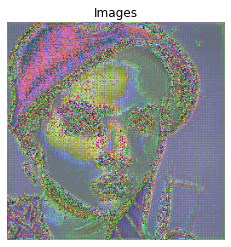

In [ ]:
show_batch_images(z)

####PatchGan Checking

In [ ]:
disc = Discriminator(6, 1)

In [ ]:
xx = torch.cat([x, x], axis=1)

In [ ]:
y = disc(xx)

In [ ]:
y.shape

torch.Size([1, 1, 16, 16])

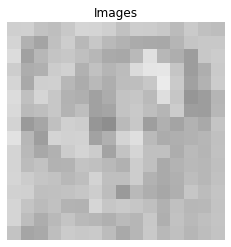

In [ ]:
show_batch_images(y)

#Model Losses

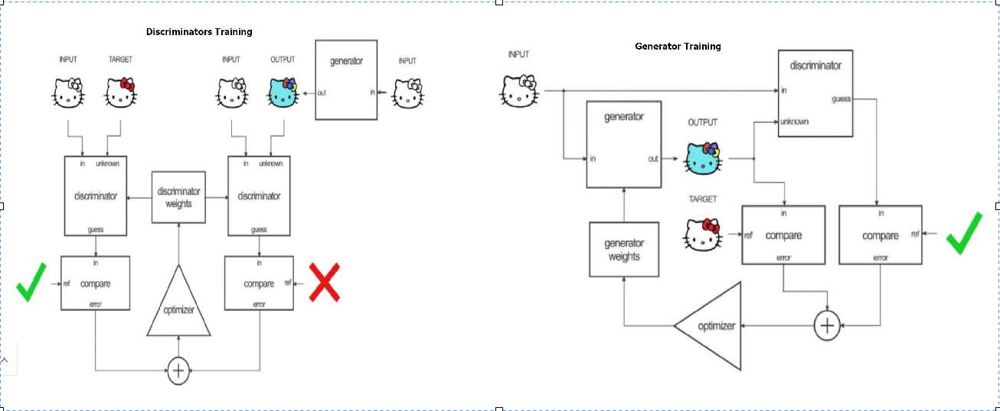

Input --- that is the image provide by us for conversion (also called condition)

Output --- that is the image generated by our generator

Target --- the image we want our generator to generate

Discriminator Loss

In [ ]:
def get_disc_loss(fake_predict, real_predict, criterion=None):
  '''
    Return the Discrimantor loss
    
    Parameters:
      fake_predict - prediction of discriminator on fake/outputed images
      real_predict - prediction of discriminator on real/target images
      criterion - criteria used to calculate loss

    Note:
      if criterion == None then BCELoss is used
  '''
  if criterion==None:
    criterion = torch.nn.BCELoss()
  #loss during predicting fake/output images
  fake_loss = criterion(fake_predict, torch.zeros_like(fake_predict))

  #loss during predicting real/target images
  real_loss = criterion(real_predict, torch.ones_like(fake_predict))

  return (fake_loss+real_loss)/2
assert get_disc_loss(torch.tensor([0.0, 0.0, 0.0]), torch.tensor([1.0, 1.0, 1.0])).item() <= 0.5033
assert get_disc_loss(torch.tensor([1.0, 1.0, 1.0]), torch.tensor([0.0, 0.0, 0.0])).item() >= 1.0032

Generator Loss

In [ ]:
def get_gen_loss(fake, fake_predict, real, adv_criterion=None, recon_criterion=None, lambda_recon=None):
  '''
    Return Generator Loss

    Parameters:
      fake :-    images generated by generator "output" images
      fake_predict :- prediction of discriminator on generated/output images
      real :-    the target images we trying to achieve
      adv_criterion :- the criterion to evaluate adversial loss bw target and output images
      recon_criterion :- the criteria to evaluate the difference b/w constructed and  target images 
      lambda_recon :- weights of recon_loss in total loss

    Note:
      if Parameters are not explicitly provided inplace of "None" the default values are assigned 
  '''
  if adv_criterion==None:
    adv_criterion = torch.nn.BCELoss()
  if recon_criterion==None:
    recon_criterion = torch.nn.L1Loss()
  if lambda_recon==None:
    lambda_recon = 100

  adv_loss = adv_criterion(fake_predict, torch.zeros_like(fake_predict))

  recon_loss = recon_criterion(real, fake)  #reconstruction loss

  return adv_loss + lambda_recon*recon_loss

assert get_gen_loss(torch.tensor([0.0, 0.0, 0.0]), torch.tensor([0.0, 0.0, 0.0]), torch.tensor([1.0, 1.0, 1.0])).item() >= 1
assert get_gen_loss(torch.tensor([0.0, 0.0, 0.0]), torch.tensor([1.0, 1.0, 1.0]), torch.tensor([1.0, 1.0, 1.0])).item() >= 2

#Training

In [ ]:
EPOCHS = 500
INPUT_DIM = 3
TARGET_DIM = 3
LEARNING_RATE = 0.0002
BETAs = (0.5, 0.99)
DISPLAY_STEP = 5

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

Model Instances

In [ ]:
gen = U_Net(INPUT_DIM, TARGET_DIM).to(device)
disc = Discriminator(INPUT_DIM + TARGET_DIM).to(device)

Optimizers

In [ ]:
gen_opt = torch.optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=BETAs)
disc_opt = torch.optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=BETAs)

Learning Rate shedulers

In [ ]:
gen_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(gen_opt, mode='min', factor=0.9, patience=5, threshold=0.001, cooldown=3, min_lr=0.00002, verbose=True)
disc_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(disc_opt, mode='min', factor=0.9, patience=5, threshold=0.001, cooldown=3, min_lr=0.00002, verbose=True)

Weight Initialization

In [ ]:
def weights_init(model):
  if isinstance(model, torch.nn.Conv2d) or isinstance(model, torch.nn.ConvTranspose2d):
      torch.nn.init.normal_(model.weight, 0.0, 0.02)
  if isinstance(model, torch.nn.BatchNorm2d):
      torch.nn.init.normal_(model.weight, 0.0, 0.02)
      torch.nn.init.constant_(model.bias, 0)
    

pretrained = True
disc_state_dict_path = "/content/drive/MyDrive/Colab Notebooks/SoC-2022/Pix2Pix/Pix2pix discriminators weight/weights"
gen_state_dict_path = "/content/drive/MyDrive/Colab Notebooks/SoC-2022/Pix2Pix/Pix2pix generators weight/weights" 
if pretrained:
    gen_loaded_state = torch.load(gen_state_dict_path)
    disc_loaded_state = torch.load(disc_state_dict_path)
    gen.load_state_dict(gen_loaded_state["gen_model_state_dict"])
    gen_opt.load_state_dict(gen_loaded_state["gen_optimizer_state_dict"])
    disc.load_state_dict(disc_loaded_state["desc_model_state_dict"])
    disc_opt.load_state_dict(disc_loaded_state["desc_optimizer_state_dict"])
else:
    gen = gen.apply(weights_init)
    disc = disc.apply(weights_init)

In [ ]:
history = {'gen_loss_history':[], 'disc_loss_history':[]}
def train():
  gen_mean_epoch_loss = 0.0
  disc_mean_epoch_loss = 0.0

  min_gen_mean_epoch_loss = float('inf')
  min_disc_mean_epoch_loss = float('inf')

  for epoch in range(EPOCHS):
    gen_epoch_loss = 0.0
    disc_epoch_loss = 0.0

    for batch, data in enumerate(dataloader):
      target, input = data
      target = target.to(device)
      input = input.to(device)

      #------- trainingn discriminator -----#
      disc_opt.zero_grad()
      with torch.no_grad():
        output = gen(input)
      
      fake_predict  = disc(torch.cat([output.detach(), input], axis=1))
      real_predict = disc(torch.cat([target, input], axis=1))
      disc_loss = get_disc_loss(fake_predict, real_predict)
      disc_loss.backward(retain_graph=True) # Update gradients
      disc_opt.step() # Update optimizer
      disc_epoch_loss += disc_loss.cpu().detach().numpy()

      #--------training generator -----------#
      gen_opt.zero_grad()
      output = gen(input)
      fake_predict = disc(torch.cat([output.detach(), input], axis=1))
      gen_loss = get_gen_loss(output, fake_predict, target)
      gen_loss.backward() # Update gradients
      gen_opt.step() # Update optimizer
      gen_epoch_loss += gen_loss.cpu().detach().numpy()
    
    #----------sheduling lr---------------#
    # disc_scheduler.step(disc_epoch_loss)
    # gen_scheduler.step(gen_epoch_loss)

    #------- writing epoch losses --------#
    history['gen_loss_history'].append(gen_epoch_loss)
    history['disc_loss_history'].append(disc_epoch_loss)


    disc_mean_epoch_loss += disc_epoch_loss
    gen_mean_epoch_loss += gen_epoch_loss

    if epoch % DISPLAY_STEP == 0:
      # ------ displaying some statics -----#
      disc_mean_epoch_loss /= DISPLAY_STEP
      gen_mean_epoch_loss /= DISPLAY_STEP

      print(f" After [epoch {epoch}] training ".center(100, "-"))
      print(f"The average loss of discriminator over previous {DISPLAY_STEP} epochs is- {disc_epoch_loss}")
      print(f"The average loss of generator over previous {DISPLAY_STEP} epochs is- {gen_epoch_loss}")
      
      # ----- saving weights ----------#
      if disc_mean_epoch_loss < min_disc_mean_epoch_loss:
        min_disc_mean_epoch_loss = disc_mean_epoch_loss
        print(' saving descriminators weights '.center(50, '-'))
        torch.save({
              'epoch': epoch,
              'desc_model_state_dict': disc.state_dict(),
              'desc_optimizer_state_dict': disc_opt.state_dict(),
              'loss': disc_epoch_loss,
              }, r'/content/drive/MyDrive/Colab Notebooks/SoC-2022/Pix2Pix/Pix2pix discriminators weight/weights')
      
      if gen_mean_epoch_loss < min_gen_mean_epoch_loss:
        min_gen_mean_epoch_loss = gen_mean_epoch_loss
        print(' saving generators weights '.center(50, '-'))
        torch.save({
              'epoch': epoch,
              'gen_model_state_dict': gen.state_dict(),
              'gen_optimizer_state_dict': gen_opt.state_dict(),
              'loss': gen_epoch_loss,
              }, r'/content/drive/MyDrive/Colab Notebooks/SoC-2022/Pix2Pix/Pix2pix generators weight/weights')
        
      disc_mean_epoch_loss = 0.0
      disc_mean_epoch_loss  = 0.0

      #----------plotting some images-------#
      fig = plt.figure(figsize=(10, 5))
      gs = GridSpec(nrows=1, ncols=3)

      ax00 = fig.add_subplot(gs[0, 0])
      ax01 = fig.add_subplot(gs[0, 1])
      ax02 = fig.add_subplot(gs[0, 2])
      show_batch_images(input, nrow=1, ax=ax00, title="Input")
      show_batch_images(output, nrow=1, ax=ax01, title="Output")
      show_batch_images(target, nrow=1, ax=ax02, title="Target")
      plt.show()
      print()

------------------------------------- After [epoch 0] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00022327022692536502
The average loss of generator over previous 5 epochs is- 2484.5363636016846
--------- saving descriminators weights ----------
----------- saving generators weights ------------


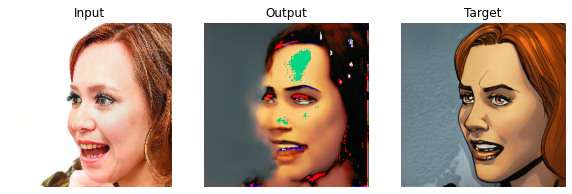


------------------------------------- After [epoch 5] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.7505816946450068
The average loss of generator over previous 5 epochs is- 1779.5362539291382


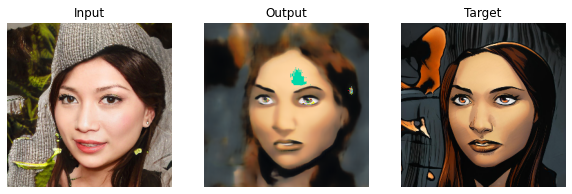


------------------------------------ After [epoch 10] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0011333830429975933
The average loss of generator over previous 5 epochs is- 1571.254316329956


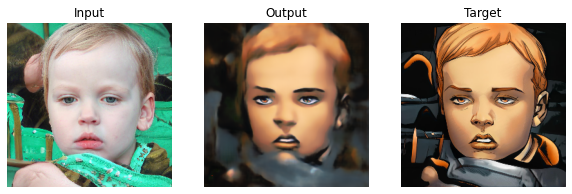


------------------------------------ After [epoch 15] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0002227722544887456
The average loss of generator over previous 5 epochs is- 1471.411949634552


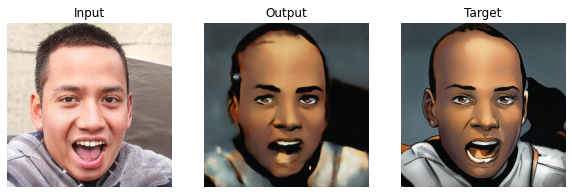


------------------------------------ After [epoch 20] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 11.169984839232136
The average loss of generator over previous 5 epochs is- 1403.1701674461365


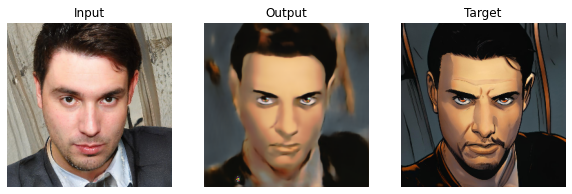


------------------------------------ After [epoch 25] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0012020770801086655
The average loss of generator over previous 5 epochs is- 1358.1035408973694


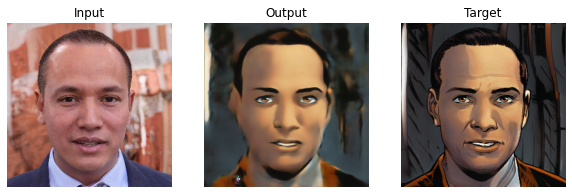


------------------------------------ After [epoch 30] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.004049111515087134
The average loss of generator over previous 5 epochs is- 1324.5448627471924


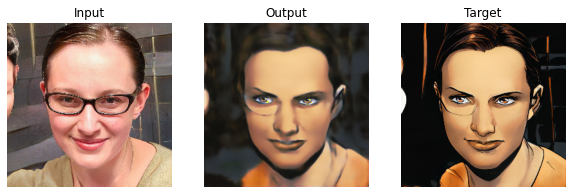


------------------------------------ After [epoch 35] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.000904937382586013
The average loss of generator over previous 5 epochs is- 1304.8816618919373


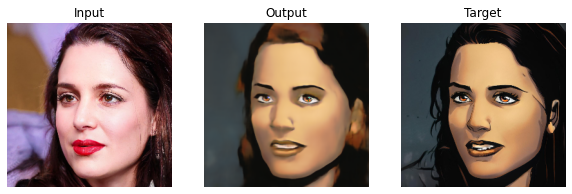


------------------------------------ After [epoch 40] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0026698354937479962
The average loss of generator over previous 5 epochs is- 1288.2949380874634


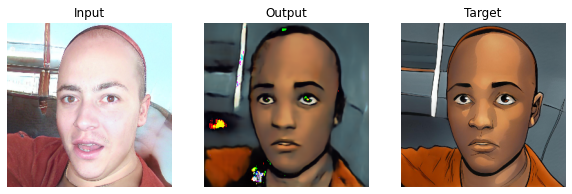


------------------------------------ After [epoch 45] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0002915214640495378
The average loss of generator over previous 5 epochs is- 1266.354420185089


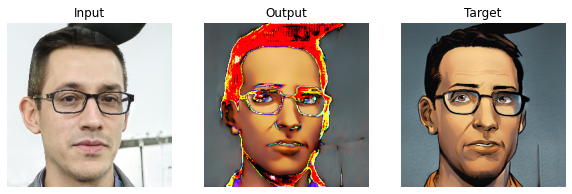


------------------------------------ After [epoch 50] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 6.557461776424134e-05
The average loss of generator over previous 5 epochs is- 1253.9355478286743


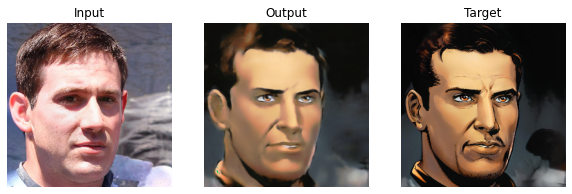


------------------------------------ After [epoch 55] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.477541942624839e-05
The average loss of generator over previous 5 epochs is- 1242.0353021621704
--------- saving descriminators weights ----------


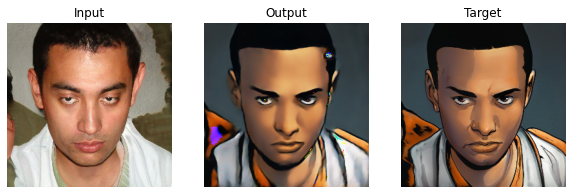


------------------------------------ After [epoch 60] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.002733028334262144
The average loss of generator over previous 5 epochs is- 1234.2903900146484


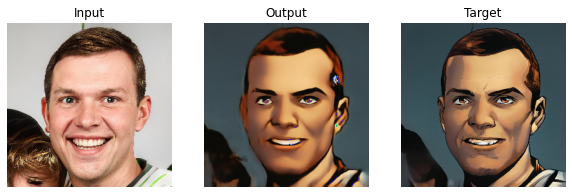


------------------------------------ After [epoch 65] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.008050840356872868
The average loss of generator over previous 5 epochs is- 1221.6059460639954


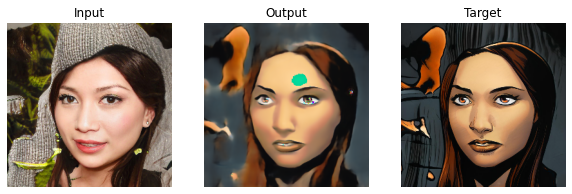


------------------------------------ After [epoch 70] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0006017035771606061
The average loss of generator over previous 5 epochs is- 1211.9310941696167


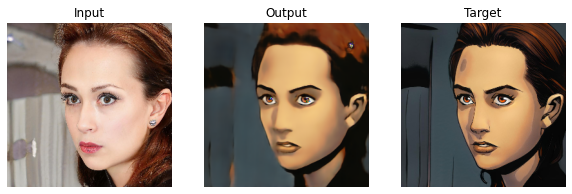


------------------------------------ After [epoch 75] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 3.056189135692293
The average loss of generator over previous 5 epochs is- 1205.5375151634216


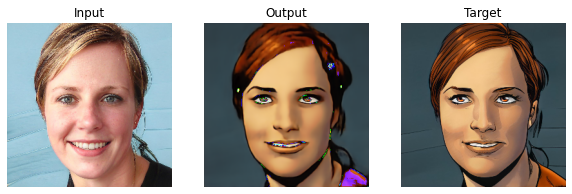


------------------------------------ After [epoch 80] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0012251951617940904
The average loss of generator over previous 5 epochs is- 1193.0717034339905


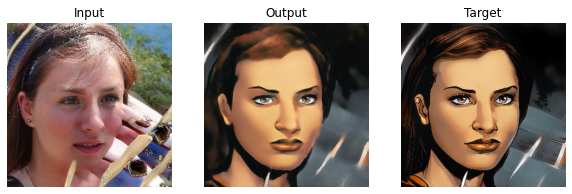


------------------------------------ After [epoch 85] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00020384670538931005
The average loss of generator over previous 5 epochs is- 1190.0801639556885


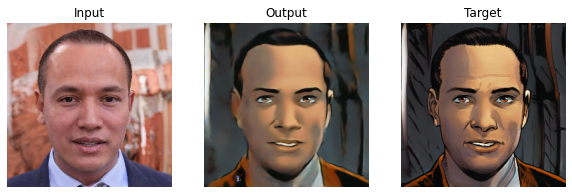


------------------------------------ After [epoch 90] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00010398591164673121
The average loss of generator over previous 5 epochs is- 1183.8859190940857


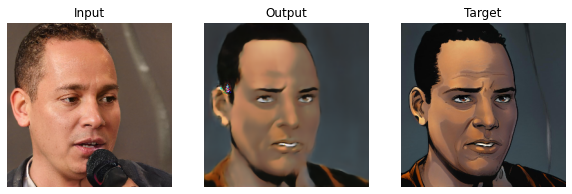


------------------------------------ After [epoch 95] training -------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.003643873068256198
The average loss of generator over previous 5 epochs is- 1176.1918926239014


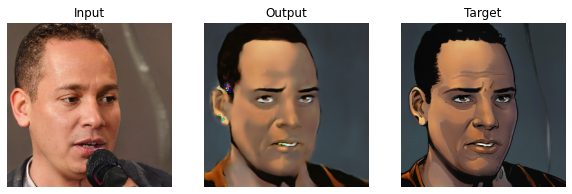


------------------------------------ After [epoch 100] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0005148337215246102
The average loss of generator over previous 5 epochs is- 1164.4814729690552


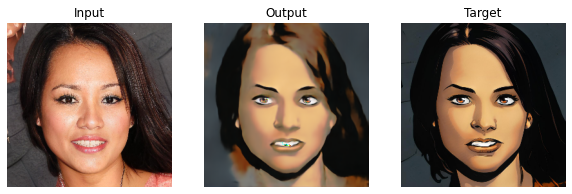


------------------------------------ After [epoch 105] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0003406172736077906
The average loss of generator over previous 5 epochs is- 1164.7754611968994


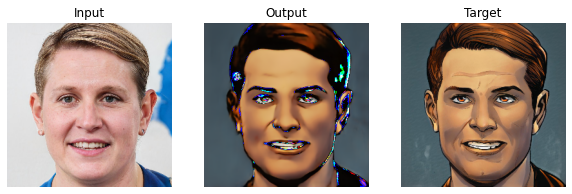


------------------------------------ After [epoch 110] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 7.248939683535127e-05
The average loss of generator over previous 5 epochs is- 1162.9428668022156


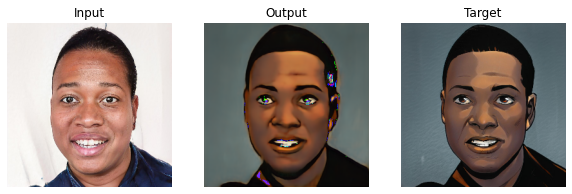


------------------------------------ After [epoch 115] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.7702902166026888e-05
The average loss of generator over previous 5 epochs is- 1162.349672794342


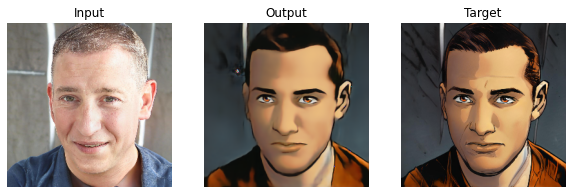


------------------------------------ After [epoch 120] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 5.090380850614196e-06
The average loss of generator over previous 5 epochs is- 1148.6844573020935
--------- saving descriminators weights ----------


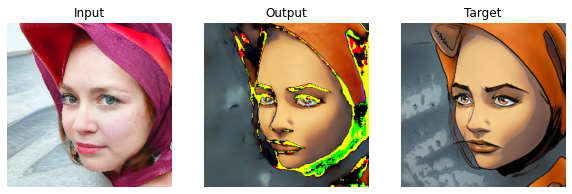


------------------------------------ After [epoch 125] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0395702815321215
The average loss of generator over previous 5 epochs is- 1154.2088031768799


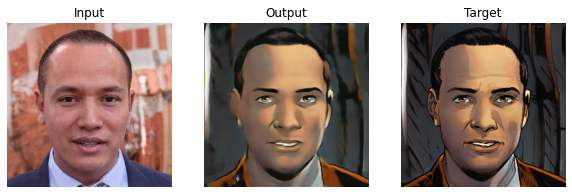


------------------------------------ After [epoch 130] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0002989028324051901
The average loss of generator over previous 5 epochs is- 1147.83131980896


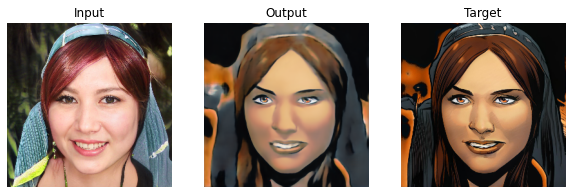


------------------------------------ After [epoch 135] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0015070271659780587
The average loss of generator over previous 5 epochs is- 1139.5299563407898


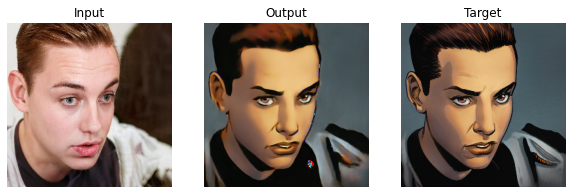


------------------------------------ After [epoch 140] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.000573178302651911
The average loss of generator over previous 5 epochs is- 1133.0042390823364


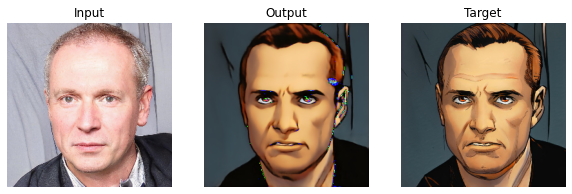


------------------------------------ After [epoch 145] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.014413826968601384
The average loss of generator over previous 5 epochs is- 1128.164828300476


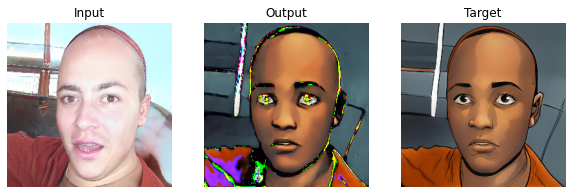


------------------------------------ After [epoch 150] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0007710246158438849
The average loss of generator over previous 5 epochs is- 1132.8911066055298


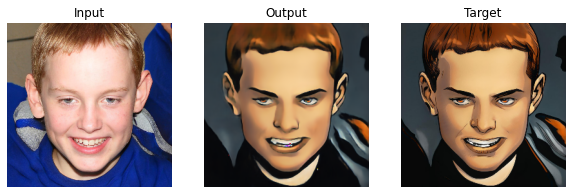


------------------------------------ After [epoch 155] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00014966397219495775
The average loss of generator over previous 5 epochs is- 1124.1586713790894


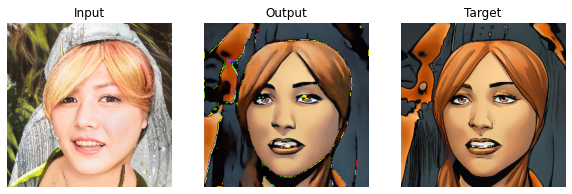


------------------------------------ After [epoch 160] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.794260228926703e-05
The average loss of generator over previous 5 epochs is- 1122.639597415924


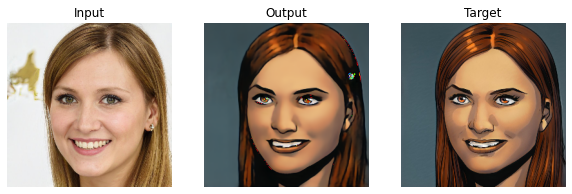


------------------------------------ After [epoch 165] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 4.6801325712664266e-06
The average loss of generator over previous 5 epochs is- 1116.906894683838
--------- saving descriminators weights ----------


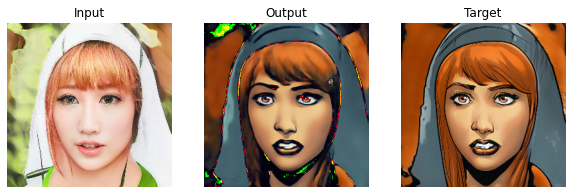


------------------------------------ After [epoch 170] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 9.725339335520111e-07
The average loss of generator over previous 5 epochs is- 1115.159550666809
--------- saving descriminators weights ----------


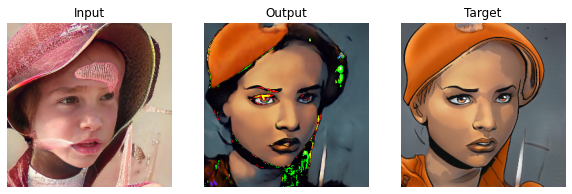


------------------------------------ After [epoch 175] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.9697475259206065e-07
The average loss of generator over previous 5 epochs is- 1115.2816138267517
--------- saving descriminators weights ----------


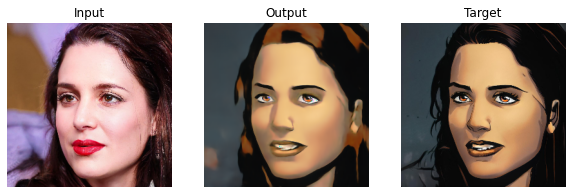


------------------------------------ After [epoch 180] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0025505735729751677
The average loss of generator over previous 5 epochs is- 1119.3254590034485


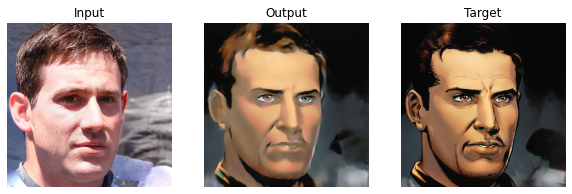


------------------------------------ After [epoch 185] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0004085453966951036
The average loss of generator over previous 5 epochs is- 1108.218924999237


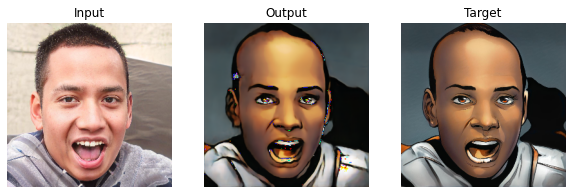


------------------------------------ After [epoch 190] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 7.508529050426205e-05
The average loss of generator over previous 5 epochs is- 1112.7094326019287


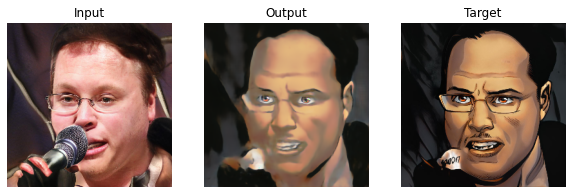


------------------------------------ After [epoch 195] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.001291984944529645
The average loss of generator over previous 5 epochs is- 1099.8098940849304


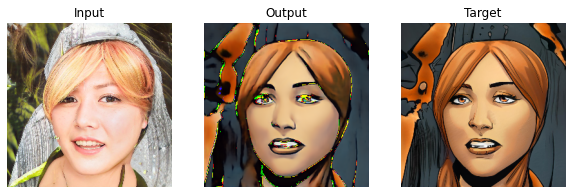


------------------------------------ After [epoch 200] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00013999735282510528
The average loss of generator over previous 5 epochs is- 1104.9143500328064


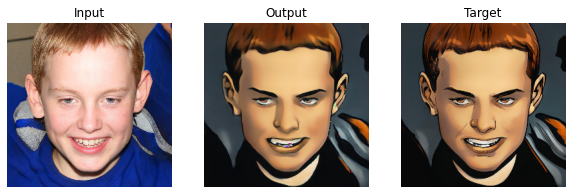


------------------------------------ After [epoch 205] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.045507858661949285
The average loss of generator over previous 5 epochs is- 1097.640516281128


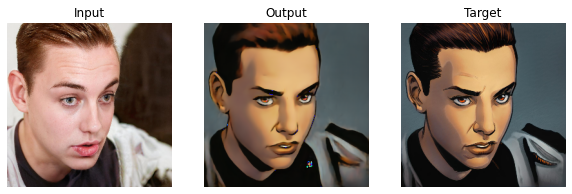


------------------------------------ After [epoch 210] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.18641987201647225
The average loss of generator over previous 5 epochs is- 1097.8523898124695


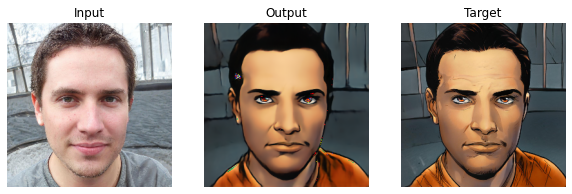


------------------------------------ After [epoch 215] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00025285118769602377
The average loss of generator over previous 5 epochs is- 1093.4561638832092


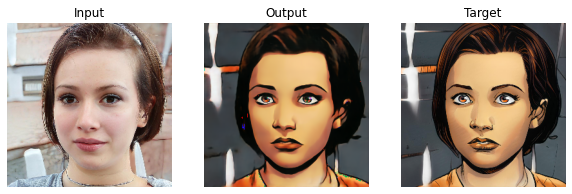


------------------------------------ After [epoch 220] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00010366553187424188
The average loss of generator over previous 5 epochs is- 1095.1494297981262


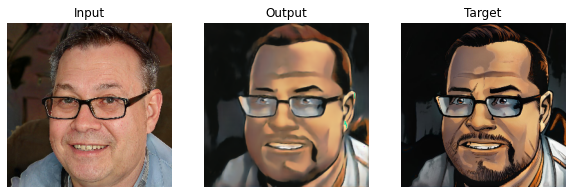


------------------------------------ After [epoch 225] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 3.4719525929816086e-05
The average loss of generator over previous 5 epochs is- 1093.5307021141052


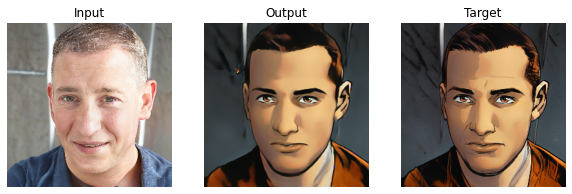


------------------------------------ After [epoch 230] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.007150745327322738
The average loss of generator over previous 5 epochs is- 1090.1068534851074


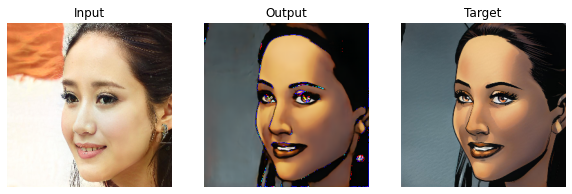


------------------------------------ After [epoch 235] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0006608494499928952
The average loss of generator over previous 5 epochs is- 1087.5643186569214


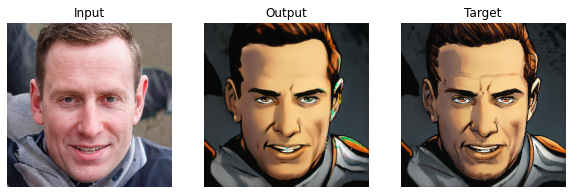


------------------------------------ After [epoch 240] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 6.879863726894087e-05
The average loss of generator over previous 5 epochs is- 1086.4761419296265


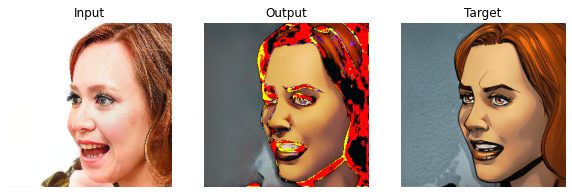


------------------------------------ After [epoch 245] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.2492071041592112e-05
The average loss of generator over previous 5 epochs is- 1087.445213317871


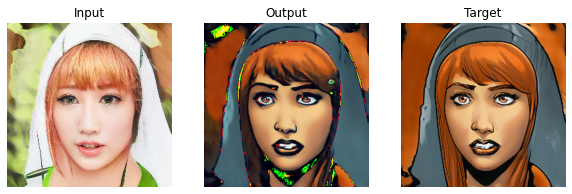


------------------------------------ After [epoch 250] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.974754343936347e-06
The average loss of generator over previous 5 epochs is- 1090.5424447059631


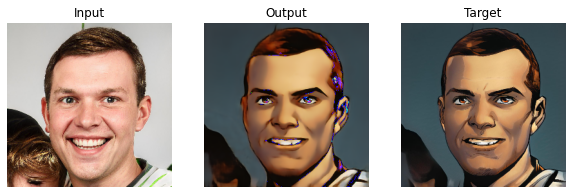


------------------------------------ After [epoch 255] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.9057268602361574e-07
The average loss of generator over previous 5 epochs is- 1082.6881680488586


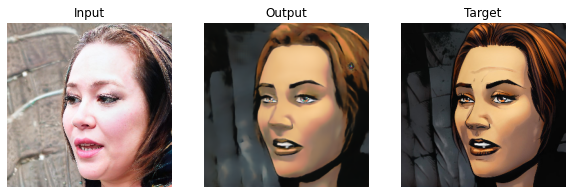


------------------------------------ After [epoch 260] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.004504859807553885
The average loss of generator over previous 5 epochs is- 1081.5106930732727


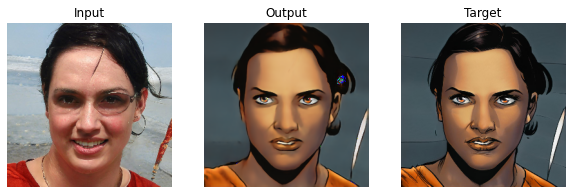


------------------------------------ After [epoch 265] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0004176107632289927
The average loss of generator over previous 5 epochs is- 1080.6447701454163


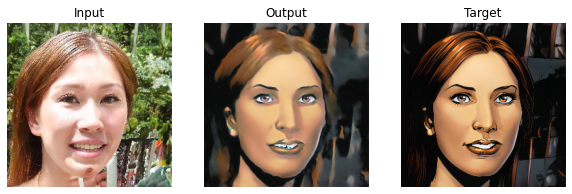


------------------------------------ After [epoch 270] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0006025381514795924
The average loss of generator over previous 5 epochs is- 1075.0957050323486


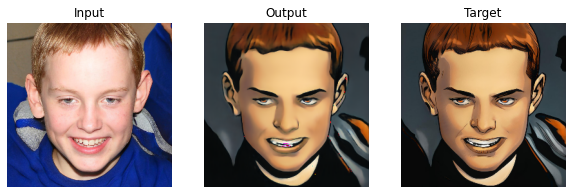


------------------------------------ After [epoch 275] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 5.0750172855273945e-06
The average loss of generator over previous 5 epochs is- 1075.400939464569


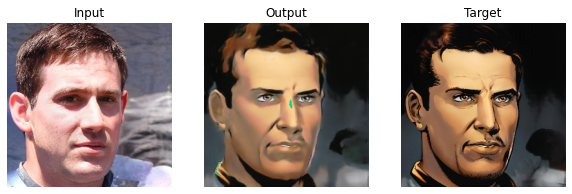


------------------------------------ After [epoch 280] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.3485555294678875e-06
The average loss of generator over previous 5 epochs is- 1074.0466923713684


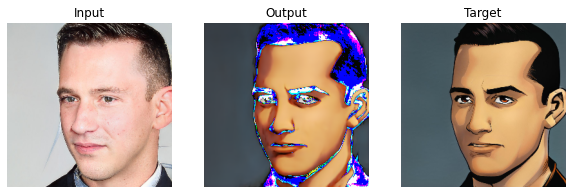


------------------------------------ After [epoch 285] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 3.010235289968577e-05
The average loss of generator over previous 5 epochs is- 1069.5411567687988


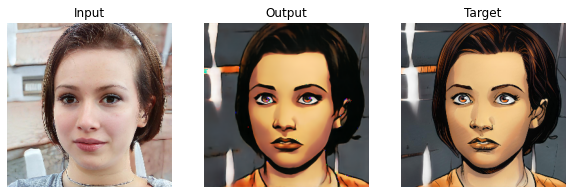


------------------------------------ After [epoch 290] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0008306888701099524
The average loss of generator over previous 5 epochs is- 1069.6336302757263


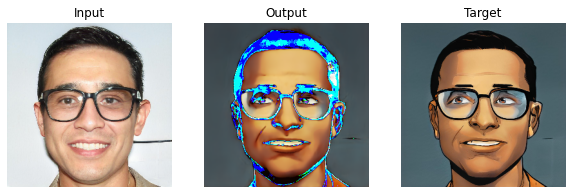


------------------------------------ After [epoch 295] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00022027594872753298
The average loss of generator over previous 5 epochs is- 1067.286741733551


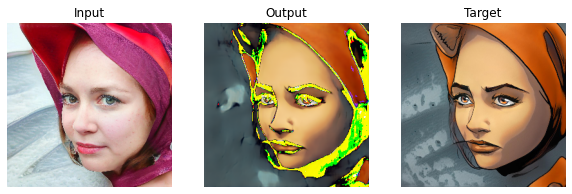


------------------------------------ After [epoch 300] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 5.134695228292685e-05
The average loss of generator over previous 5 epochs is- 1070.03892660141


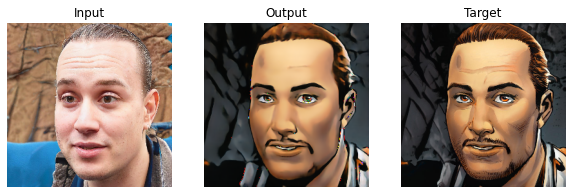


------------------------------------ After [epoch 305] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 8.698574606835763e-06
The average loss of generator over previous 5 epochs is- 1066.8193650245667


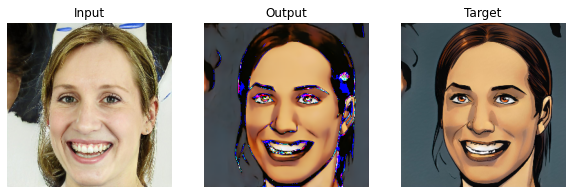


------------------------------------ After [epoch 310] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.7836013522787297e-06
The average loss of generator over previous 5 epochs is- 1064.8170418739319


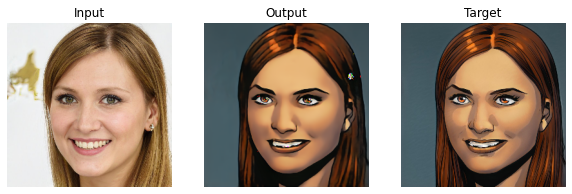


------------------------------------ After [epoch 315] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 3.065216079012334e-07
The average loss of generator over previous 5 epochs is- 1065.388237953186


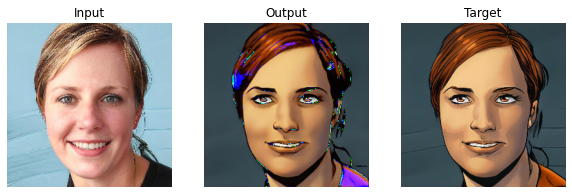


------------------------------------ After [epoch 320] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 5.579608240768863e-05
The average loss of generator over previous 5 epochs is- 1062.0330080986023


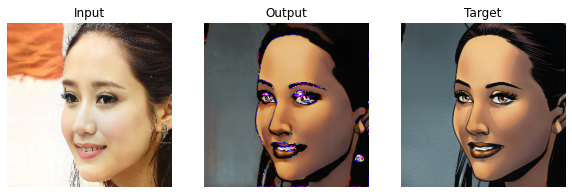


------------------------------------ After [epoch 325] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.7211379246772083e-05
The average loss of generator over previous 5 epochs is- 1060.7360923290253


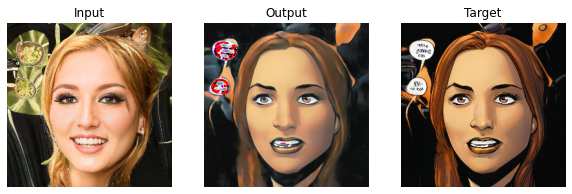


------------------------------------ After [epoch 330] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 6.57656232561088e-06
The average loss of generator over previous 5 epochs is- 1063.3782577514648


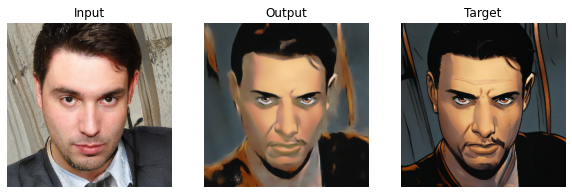


------------------------------------ After [epoch 335] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.6102579943888529e-06
The average loss of generator over previous 5 epochs is- 1060.3384294509888


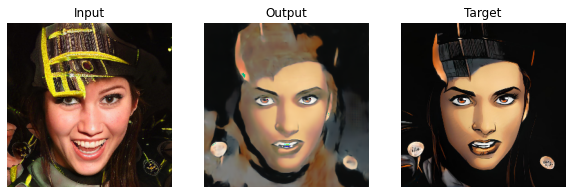


------------------------------------ After [epoch 340] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 3.665919072193269e-07
The average loss of generator over previous 5 epochs is- 1055.7686445713043


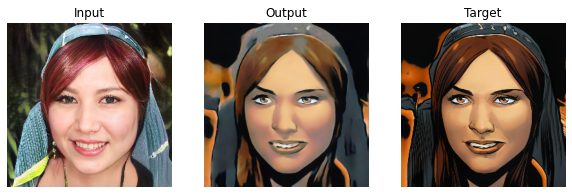


------------------------------------ After [epoch 345] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 8.649659508086494e-08
The average loss of generator over previous 5 epochs is- 1058.8501436710358
--------- saving descriminators weights ----------


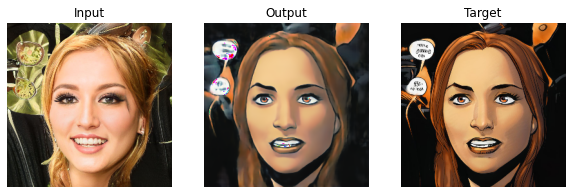


------------------------------------ After [epoch 350] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 3.317837055094586e-08
The average loss of generator over previous 5 epochs is- 1056.649872303009
--------- saving descriminators weights ----------


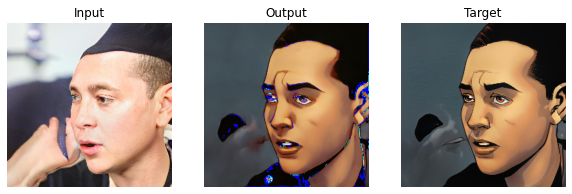


------------------------------------ After [epoch 355] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.0029147458594867004
The average loss of generator over previous 5 epochs is- 1056.0944213867188


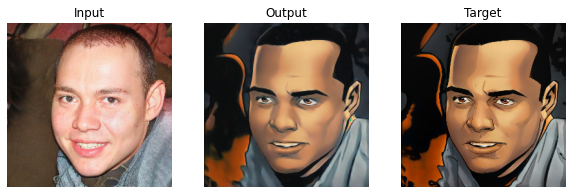


------------------------------------ After [epoch 360] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00012517027056713204
The average loss of generator over previous 5 epochs is- 1055.7158513069153


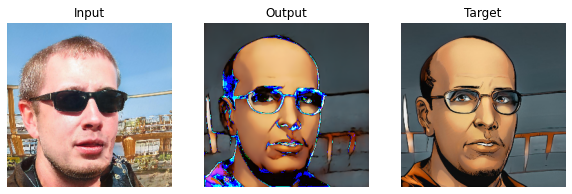


------------------------------------ After [epoch 365] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.4750704886878907e-05
The average loss of generator over previous 5 epochs is- 1050.8797233104706


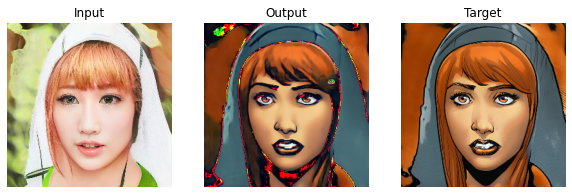


------------------------------------ After [epoch 370] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.229122642416481e-06
The average loss of generator over previous 5 epochs is- 1048.7758688926697


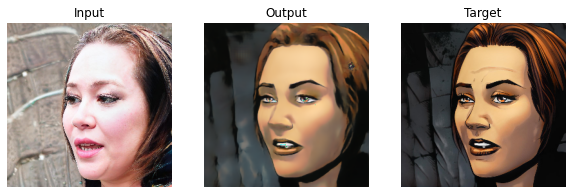


------------------------------------ After [epoch 375] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00019589122838037376
The average loss of generator over previous 5 epochs is- 1057.566637992859


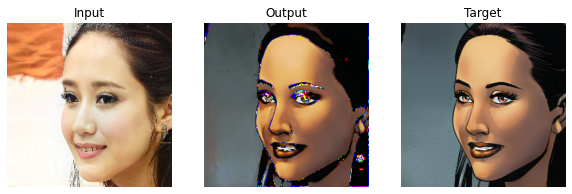


------------------------------------ After [epoch 380] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.7201430514045555e-05
The average loss of generator over previous 5 epochs is- 1056.2645168304443


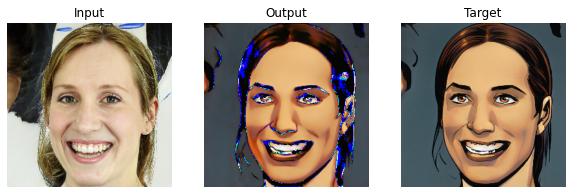


------------------------------------ After [epoch 385] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 4.958733059390319e-06
The average loss of generator over previous 5 epochs is- 1050.827260017395


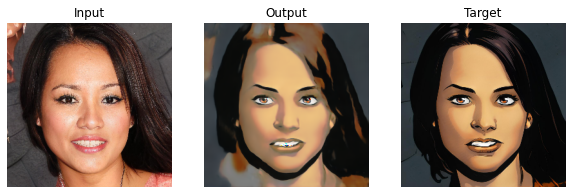


------------------------------------ After [epoch 390] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 8.726496651956239e-07
The average loss of generator over previous 5 epochs is- 1055.435832977295


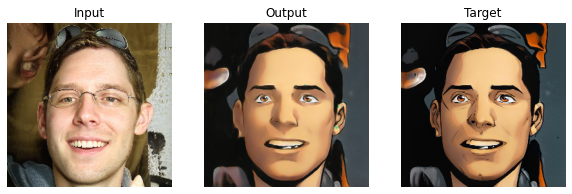


------------------------------------ After [epoch 395] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.8253925460065545e-07
The average loss of generator over previous 5 epochs is- 1048.1216597557068


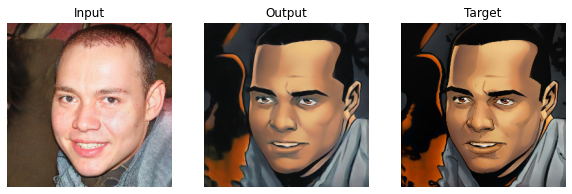


------------------------------------ After [epoch 400] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 3.108289420294952e-08
The average loss of generator over previous 5 epochs is- 1050.8819711208344


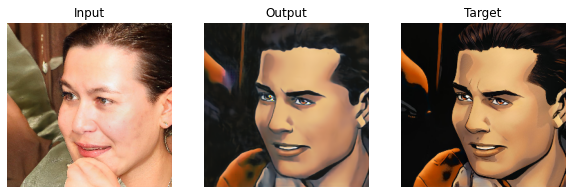


------------------------------------ After [epoch 405] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.1175871950097616e-08
The average loss of generator over previous 5 epochs is- 1045.2771263122559
--------- saving descriminators weights ----------


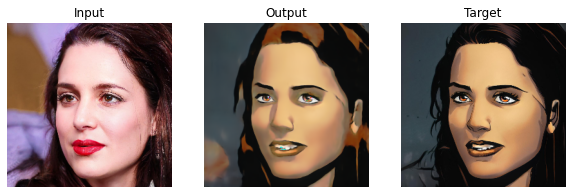


------------------------------------ After [epoch 410] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 0.00014086561409076825
The average loss of generator over previous 5 epochs is- 1045.726586818695


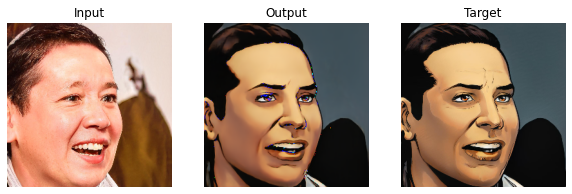


------------------------------------ After [epoch 415] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 5.668155000110309e-05
The average loss of generator over previous 5 epochs is- 1045.8649122714996


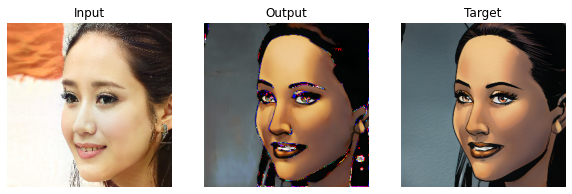


------------------------------------ After [epoch 420] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.378491838894714e-05
The average loss of generator over previous 5 epochs is- 1045.5879480838776


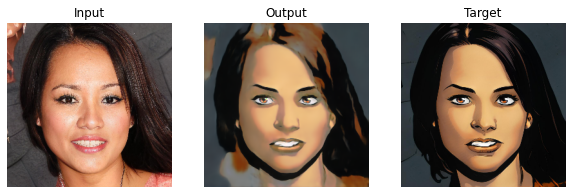


------------------------------------ After [epoch 425] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 3.2741987540385598e-06
The average loss of generator over previous 5 epochs is- 1040.4152193069458


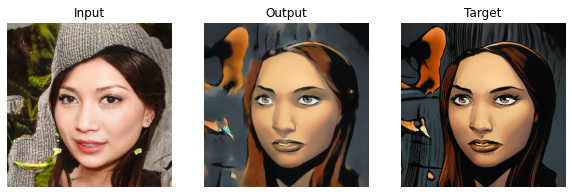


------------------------------------ After [epoch 430] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 6.316697982733377e-07
The average loss of generator over previous 5 epochs is- 1042.4336013793945


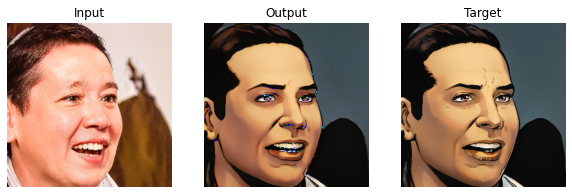


------------------------------------ After [epoch 435] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 9.904348264511142e-05
The average loss of generator over previous 5 epochs is- 1038.529997587204


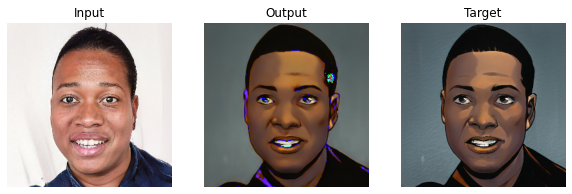


------------------------------------ After [epoch 440] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 4.3325635093349746e-05
The average loss of generator over previous 5 epochs is- 1045.1243524551392


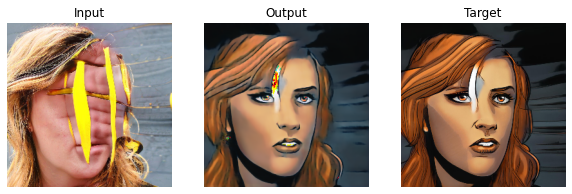


------------------------------------ After [epoch 445] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.5700283608820484e-05
The average loss of generator over previous 5 epochs is- 1034.5539934635162


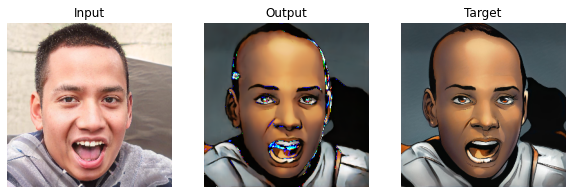


------------------------------------ After [epoch 450] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 7.005735413012637e-06
The average loss of generator over previous 5 epochs is- 1037.4268116950989


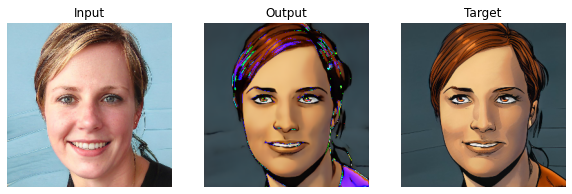


------------------------------------ After [epoch 455] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.8856972948122497e-06
The average loss of generator over previous 5 epochs is- 1036.2351715564728


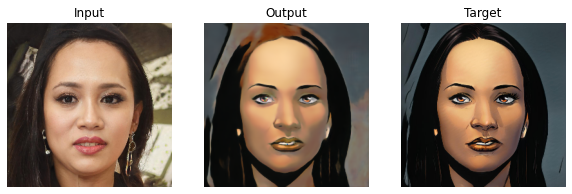


------------------------------------ After [epoch 460] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.3480974165046575e-07
The average loss of generator over previous 5 epochs is- 1032.289489030838


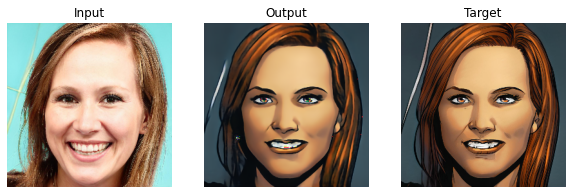


------------------------------------ After [epoch 465] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.9860602324127683e-07
The average loss of generator over previous 5 epochs is- 1033.2972571849823


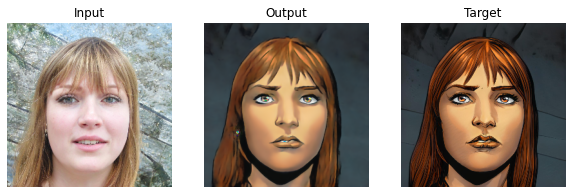


------------------------------------ After [epoch 470] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.1990779397175189e-08
The average loss of generator over previous 5 epochs is- 1035.4869754314423
--------- saving descriminators weights ----------


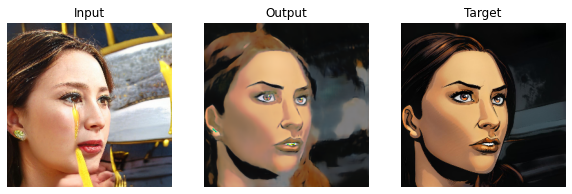


------------------------------------ After [epoch 475] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 6.868504848211998e-09
The average loss of generator over previous 5 epochs is- 1032.1096274852753
--------- saving descriminators weights ----------


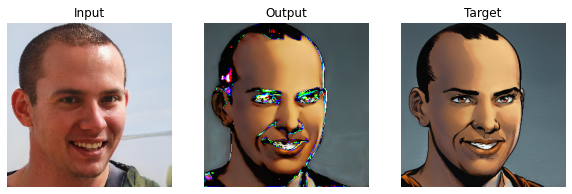


------------------------------------ After [epoch 480] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 9.080395657612428e-09
The average loss of generator over previous 5 epochs is- 1031.0203638076782


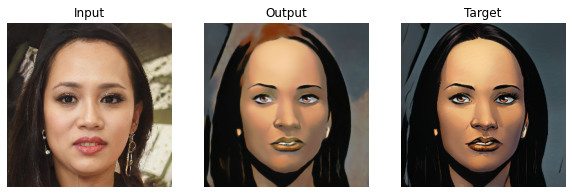


------------------------------------ After [epoch 485] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 1.0074584541497345e-05
The average loss of generator over previous 5 epochs is- 1033.3225989341736


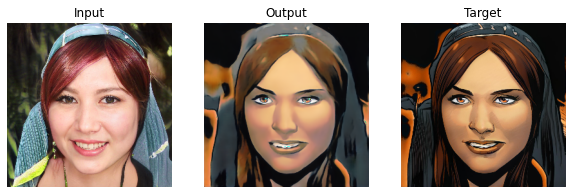


------------------------------------ After [epoch 490] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.4040939629321745e-05
The average loss of generator over previous 5 epochs is- 1035.012976884842


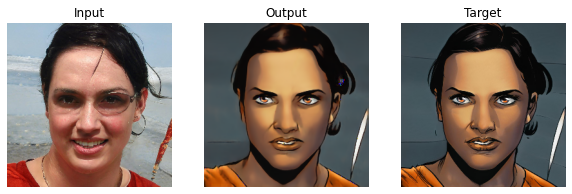


------------------------------------ After [epoch 495] training ------------------------------------
The average loss of discriminator over previous 5 epochs is- 2.2798940875756735e-06
The average loss of generator over previous 5 epochs is- 1030.9475750923157


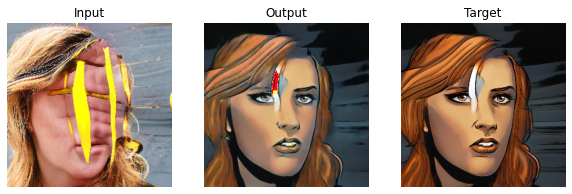

In [ ]:
train()

In [ ]:
torch.save({
              'epoch': 160,
              'desc_model_state_dict': disc.state_dict(),
              'desc_optimizer_state_dict': disc_opt.state_dict(),
              'loss': 8.056217892084533,
              }, r'/content/drive/MyDrive/Colab Notebooks/SoC-2022/Pix2Pix/Pix2pix discriminators weight/weights')

In [ ]:
torch.save({
              'epoch': 160,
              'gen_model_state_dict': gen.state_dict(),
              'gen_optimizer_state_dict': gen_opt.state_dict(),
              'loss': 1615.222373008728,
              }, r'/content/drive/MyDrive/Colab Notebooks/SoC-2022/Pix2Pix/Pix2pix generators weight/weights')

#Prediction By Model

creating a new model instance and initializing using learned weights

In [ ]:
gen_p = U_Net(3, 3)

In [ ]:
gen_loaded_state = torch.load(gen_state_dict_path)
gen_p.load_state_dict(gen_loaded_state["gen_model_state_dict"])

<All keys matched successfully>

In [ ]:
index = 521 #changw the index for different image (index<10000)

In [ ]:
target, input = transforms(Image.open(comic_fnames[index])), transforms(Image.open(real_fnames[index])) # loading images

In [ ]:
input.device, input.shape, target.shape

(device(type='cpu'), torch.Size([3, 256, 256]), torch.Size([3, 256, 256]))

In [ ]:
with torch.no_grad():
  output = gen_p(input.view(1, 3, 256, 256))

In [ ]:
output.shape

torch.Size([1, 3, 256, 256])

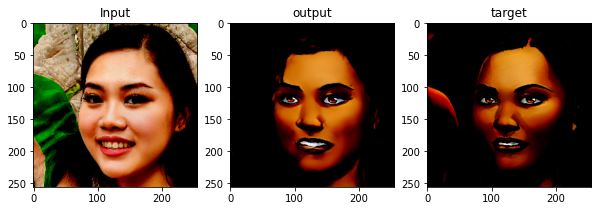

In [ ]:
fig = plt.figure(figsize=(10, 5))
gs = GridSpec(nrows=1, ncols=3)

ax00 = fig.add_subplot(gs[0, 0])
ax01 = fig.add_subplot(gs[0, 1])
ax02 = fig.add_subplot(gs[0, 2])
ax00.imshow(input.view(3, 256, 256).permute(1, 2, 0).numpy())
ax00.set_title("Input")
ax01.imshow(output.view(3, 256, 256).permute(1, 2, 0))
ax01.set_title("output")
ax02.imshow(target.view(3, 256, 256).permute(1, 2, 0))
ax02.set_title("target")
plt.show()

#Model Performance Analysis

Few Notes:-

* I have trained model for only 100 images here and giving good enough results
* The accuracy can be increased by training on more data with larger batch size
* Transform function can be modified the resizing of images could be change, the loading of images can be done differently
* different transforms for target and input can be used

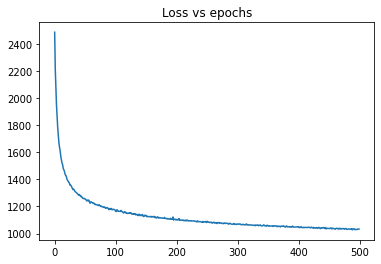

In [ ]:
#The model was trained in pices so the history here is only last 500 epochs and the history of 500 epochs before that is not shown here
plt.plot(history['gen_loss_history'], label="generator loss")
plt.title("Loss vs epochs");

Observations-
* The generators loss curve is smooth and going down so we can achieve better accuracy if we train longer

* We can train on more and original data to obtain low variance and generalize Result

* our model not only cartoonizes the images but learned to put some extra features like smile, Filling some missing part in image etc. example shown below

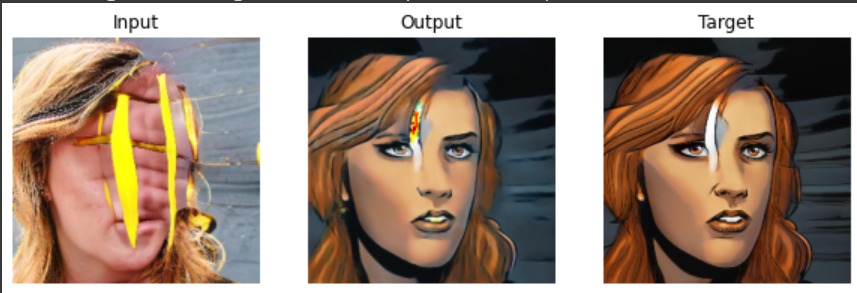

---